In [243]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from imblearn.over_sampling import SMOTE
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from yellowbrick.classifier import ClassificationReport
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import KFold
from xgboost import XGBClassifier
from sklearn.metrics import roc_auc_score

## Data Understanding

The dataset contains 3,333 rows and 21 columns, which can be categorized into areas relevant to customer churn prediction. Here's a breakdown of these categories:

**1. Customers Information**

This information will help the sales and marketing department understand customer behavior and come up with better strategies:

- **State:** This represents the customer's state of residence.

- **Account Length:** This indicates how many months a cstomer has had an account with the company.

- **Area Code:** Similar to state, this identifies the customer's area code.

- **Phone Number:** This unique identifier but will not be used in analysis.

**2. Mobile Plans**

These columns provide insights into how charges impact customer churn:

- **International Plan:** This binary variable indicates whether the customer has an international calling plan (1) or not (0).

- **Voicemail Plan:** This binary variable indicates whether the customer has a voicemail plan (1) or not (0).

- **Number of Voicemail Messages:** This numerical variable represents the total number of voicemail messages received by the customer.

**3. Call Activity**

These columns help understand how customer usage patterns affect churn:

- **Total Day Minutes, Calls, and Charges:** These numerical variables capture the total minutes spent, number of calls made, and total charges incurred during daytime hours.

- **Total Evening Minutes, Calls, and Charges:** Similar to the above, these features represent usage and charges for evening calls. Analyzing these alongside daytime usage can reveal customer preferences.

- **Total Night Minutes, Calls, and Charges:** These capture usage and charges for calls made at night. Understanding nighttime usage patterns can inform targeted marketing strategies.

- **Total International Minutes, Calls, and Charges:** These features represent the total minutes, number of calls, and charges associated with international calls. High international calling volumes might influence churn if plans are not aligned with customer needs.

**4. Customer Service Interaction**


- **Customer Service Calls:** This numerical variable indicates the total number of calls made by the customer to SyriaTel's customer service department. High call volume might indicate service dissatisfaction or need for improved self-service options. This can be a key performance indicator (KPI) for customer service effectiveness.

**5. Target Variable**

- **Churn:** This binary variable is the target variable of the dataset. It indicates whether the customer churned (1) or did not churn (0). This is the key variable used to predict customer churn.

## Next Steps for Data Exploration

To gain a deeper understanding of the data, we should perform the following:

1. **Unique Values:** Identify the number of unique values for each categorical variable.
2. **Statistical Description:** Calculate summary statistics (mean, median, standard deviation) for numerical variables.
3. **Target Variable Distribution:** Analyze the distribution of the "churn" variable to understand the proportion of churning and non-churning customers.
4. **Irrelevant Columns:** Evaluate the relevance of each column to the prediction task and consider dropping any irrelevant features.

By following these steps, we can gain valuable insights into the SyriaTel dataset and prepare it for effective customer churn prediction modeling.

In [244]:
data = pd.read_csv('/content/bigml_59c28831336c6604c800002a.csv')
data.head()

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [245]:
#Unique Values
data.nunique()

state                       51
account length             212
area code                    3
phone number              3333
international plan           2
voice mail plan              2
number vmail messages       46
total day minutes         1667
total day calls            119
total day charge          1667
total eve minutes         1611
total eve calls            123
total eve charge          1440
total night minutes       1591
total night calls          120
total night charge         933
total intl minutes         162
total intl calls            21
total intl charge          162
customer service calls      10
churn                        2
dtype: int64

In [246]:
#overview
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   state                   3333 non-null   object 
 1   account length          3333 non-null   int64  
 2   area code               3333 non-null   int64  
 3   phone number            3333 non-null   object 
 4   international plan      3333 non-null   object 
 5   voice mail plan         3333 non-null   object 
 6   number vmail messages   3333 non-null   int64  
 7   total day minutes       3333 non-null   float64
 8   total day calls         3333 non-null   int64  
 9   total day charge        3333 non-null   float64
 10  total eve minutes       3333 non-null   float64
 11  total eve calls         3333 non-null   int64  
 12  total eve charge        3333 non-null   float64
 13  total night minutes     3333 non-null   float64
 14  total night calls       3333 non-null   

In [247]:
# statistical description
data.describe()

,account length,area code,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856
std,39.822106,42.371290,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000
50%,101.000000,415.000000,0.000000,179.400000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000
75%,127.000000,510.000000,20.000000,216.400000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000
max,243.000000,510.000000,51.000000,350.800000,165.000000,59.640000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000


In [248]:
#value counts
data['churn'].value_counts()

churn
False    2850
True      483
Name: count, dtype: int64

# Data Pre-processing

In [249]:
# Drop the phone number column.
data.drop(['phone number'],axis=1,inplace=True)

### Justification


- Telemarketing with phone numbers is less effective because of privacy related issues.
   
    

In [250]:
# Check for missing values
# Loop over all missing values

null_num = []

for i in data.columns:
    x = data[i].isnull().sum()
    null_num.append(x)

# Visualize
null = pd.DataFrame(null_num,index=data.columns,columns=['Total Missing Values'])
null

,Total Missing Values
state,0
account length,0
area code,0
international plan,0
voice mail plan,0
number vmail messages,0
total day minutes,0
total day calls,0
total day charge,0
total eve minutes,0


## Categorical Values Encoding

In [251]:
label_encoder = LabelEncoder()
data['churn'] = label_encoder.fit_transform(data['churn'])
data['international plan'] = label_encoder.fit_transform(data['international plan'])
data['voice mail plan'] = label_encoder.fit_transform(data['voice mail plan'])
# Convert the columns into Boolean Format using .astype
data['churn']= data['churn'].astype('bool')
data['international plan'] = data['international plan'].astype('bool')
data['voice mail plan'] = data['voice mail plan'].astype('bool')
data.head()

,state,account length,area code,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,KS,128,415,False,True,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,False,True,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,False,False,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,True,False,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,True,False,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


# Feature Engineering

- Combine the total day minutes and total evening minutes. Create a new column called Total Minutes

- Combine the total day calls and total evening calls. Create a new column called Total Calls

- Combine the total day charge and total evening charge. Create new column called Total Charge

In [252]:
# Create Total Minutes column by adding the corresponding columns together
data['total minutes'] = data['total day minutes'] + data['total eve minutes'] + data['total night minutes'] + data['total intl minutes']
data['total calls'] = data['total day calls'] + data['total eve calls'] + data['total night calls'] + data['total intl calls']
data['total charge'] = data['total day charge'] + data['total eve charge'] + data['total night charge'] + data['total intl charge']

data.head()

,state,account length,area code,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,...,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn,total minutes,total calls,total charge
0,KS,128,415,False,True,25,265.1,110,45.07,197.4,...,91,11.01,10.0,3,2.70,1,False,717.2,303,75.56
1,OH,107,415,False,True,26,161.6,123,27.47,195.5,...,103,11.45,13.7,3,3.70,1,False,625.2,332,59.24
2,NJ,137,415,False,False,0,243.4,114,41.38,121.2,...,104,7.32,12.2,5,3.29,0,False,539.4,333,62.29
3,OH,84,408,True,False,0,299.4,71,50.90,61.9,...,89,8.86,6.6,7,1.78,2,False,564.8,255,66.80
4,OK,75,415,True,False,0,166.7,113,28.34,148.3,...,121,8.41,10.1,3,2.73,3,False,512.0,359,52.09


# Feature Importance

In [253]:
# Create a copy
data_copy = data.copy()

# Encode categorical variables
label_encoder = LabelEncoder()
one_hot_encoder = OneHotEncoder()
# transform the variables from the Label Encoder
data_copy['churn'] = label_encoder.fit_transform(data_copy['churn'])
data_copy['international plan'] = label_encoder.fit_transform(data_copy['international plan'])
data_copy['voice mail plan'] = label_encoder.fit_transform(data_copy['voice mail plan'])
data_copy['state'] = label_encoder.fit_transform(data_copy['state'])


# Split the copy data frame into independent and dependent (target) variable
X = data_copy.drop('churn', axis=1)
y = data_copy['churn']

# Train-test split the copy data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the Random Forest Classifier with 100 estimators
random_forest_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
random_forest_classifier.fit(X_train, y_train)

# Create a variable for the Feature Importance
feature_importances = random_forest_classifier.feature_importances_

# Get feature names from the copy data frame
feature_names = X.columns

# Create a data frame to store feature names and their importance values
feature_importance_data = pd.DataFrame({'Feature': feature_names,'Importance': feature_importances})

# Sort the data frame by importance values in descending order
feature_importance_data = feature_importance_data.sort_values(by='Importance', ascending=False)

print(feature_importance_data)

                   Feature  Importance
21            total charge    0.184360
18  customer service calls    0.134981
3       international plan    0.076624
8         total day charge    0.072542
19           total minutes    0.068611
6        total day minutes    0.063297
16        total intl calls    0.036181
5    number vmail messages    0.035073
4          voice mail plan    0.034519
17       total intl charge    0.032369
11        total eve charge    0.030446
9        total eve minutes    0.029920
15      total intl minutes    0.029501
12     total night minutes    0.022667
14      total night charge    0.022375
7          total day calls    0.022052
1           account length    0.021689
13       total night calls    0.020616
20             total calls    0.019782
10         total eve calls    0.018665
0                    state    0.017988
2                area code    0.005741


In [254]:
#Drop Area Code since
data.drop(['area code'],axis=1,inplace=True)

## Key Drivers of Customer Loyalty:

Our analysis revealed that spending habits and overall usage are the strongest indicators of customer loyalty in the telecommunications industry.




# Exploratory Data Analysis

# Data Analysis & Visualization

## Data Analysis

In [255]:
# Performed 1 aggregation grouped on columns: 'customer service calls', 'churn'
avg_total_calls = data.groupby(['customer service calls', 'churn']).agg(total_calls_mean=('total calls', 'mean')).reset_index()
avg_total_calls = pd.DataFrame(avg_total_calls)
avg_total_calls.head()

,customer service calls,churn,total_calls_mean
0,0,False,305.492562
1,0,True,301.369565
2,1,False,305.281398
3,1,True,314.327869
4,2,False,305.072917


In [256]:
# Create the pivot table
pivot_table = data.pivot_table(values='total charge', index='state', aggfunc=['mean', 'std', 'sum'])

# Sort the pivot table by 'total charge' in descending order and select the top 11 rows
pivot_table = pivot_table.sort_values(by=('mean', 'total charge'), ascending=False).head(11)

# Reset the index to convert the pivot table into a DataFrame
pivot_table = pivot_table.reset_index()

# Rename the columns
pivot_table.columns = ['State', 'Total Charge Mean', 'Total Charge Std', 'Total Charge Sum']
# Convert into Dataframe
pivot_table = pd.DataFrame(pivot_table)
# Display the DataFrame
pivot_table.head()


,State,Total Charge Mean,Total Charge Std,Total Charge Sum
0,IN,62.787746,9.777357,4457.93
1,NJ,62.420000,9.958284,4244.56
2,MD,62.075714,10.437810,4345.30
3,KS,61.886286,11.179182,4332.04
4,SD,61.255500,10.060912,3675.33


In [257]:
# Create the pivot table
pivot_table1 = data.pivot_table(values='total minutes', index='state', aggfunc=['mean', 'std', 'sum'])

# Sort the pivot table by 'total charge' in descending order and select the top 11 rows
pivot_table1 = pivot_table1.sort_values(by=('mean', 'total minutes'), ascending=False).head(11)

# Reset the index to convert the pivot table into a DataFrame
pivot_table1 = pivot_table1.reset_index()

# Rename the columns
pivot_table1.columns = ['State', 'Total Minutes Mean', 'Total Minutes Std', 'Total Minutes Sum']
pivot_table1 = pd.DataFrame(pivot_table1)
# Display the DataFrame
pivot_table1.head()

,State,Total Minutes Mean,Total Minutes Std,Total Minutes Sum
0,IN,619.323944,89.329022,43972.0
1,NJ,611.707353,87.021672,41596.1
2,KS,608.884286,94.261723,42621.9
3,MA,608.644615,87.526225,39561.9
4,TN,606.994340,80.338439,32170.7


In [258]:
# Create the pivot table
pivot_table4 = data.pivot_table(values='total intl charge', index='state', aggfunc=['mean', 'std', 'sum'])

# Sort the pivot table by 'total charge' in descending order and select the top 11 rows
pivot_table4 = pivot_table4.sort_values(by=('mean', 'total intl charge'), ascending=False).head(11)

# Reset the index to convert the pivot table into a DataFrame
pivot_table4 = pivot_table4.reset_index()

# Rename the columns
p1_columns = pivot_table4.columns = ['State', 'Total International Charge Mean', 'Total International Charge Std', 'Total International Charge Sum']
pivot_table4 = pd.DataFrame(pivot_table4,columns=p1_columns)
# Display the DataFrame
pivot_table4.head()

,State,Total International Charge Mean,Total International Charge Std,Total International Charge Sum
0,MD,2.943571,0.736868,206.05
1,KS,2.928714,0.841288,205.01
2,NJ,2.919265,0.685281,198.51
3,MS,2.885538,0.749481,187.56
4,KY,2.876780,0.722788,169.73


In [259]:
#Create table with mean charge customers are willing to pay
# Drop columns: 'Total International Charge Std', 'Total International Charge Sum'
pivot_table4 = pivot_table4.drop(columns=['Total International Charge Std', 'Total International Charge Sum'])
international_mean_charge = pivot_table4
international_mean_charge = international_mean_charge.sort_values(by='Total International Charge Mean',ascending=False).head(8)
international_mean_charge

,State,Total International Charge Mean
0,MD,2.943571
1,KS,2.928714
2,NJ,2.919265
3,MS,2.885538
4,KY,2.876780
5,AZ,2.870625
6,MT,2.867647
7,DC,2.864630


In [260]:
pivot_table5 = data.pivot_table(values='total intl minutes', index=['international plan'], columns='churn', aggfunc=['mean', 'std', 'sum'])

# Reset the index to convert the pivot table into a DataFrame
pivot_table5 = pivot_table5.reset_index()

# Rename the columns
pivot_table5 = pd.DataFrame(pivot_table5)
# Display the DataFrame
pivot_table5_dropped = pivot_table5 = pivot_table5.drop(columns=[('std', False), ('std', True)])
international_plan_sum_mean = pivot_table5_dropped
international_plan_sum_mean

international plan       mean                 sum        
churn                         False       True    False    True
0                  False  10.185473  10.271387  27134.1  3553.9
1                   True   9.777957  11.782482   1818.7  1614.2

In [261]:
pivot_table_voice_mail_plan = data.pivot_table(values='number vmail messages', index='voice mail plan', columns='churn', aggfunc=['sum','mean','std'])
pivot_table_voice_mail_plan = pd.DataFrame(pivot_table_voice_mail_plan)
pivot_table_voice_mail_plan_mean = pivot_table_voice_mail_plan['mean']
pivot_table_voice_mail_plan_mean

churn,False,True
voice mail plan,,
False,0.000000,0.0000
True,29.124703,30.8875


In [262]:
Customer_service_calls_data = pd.crosstab(data['customer service calls'], data["churn"])
Customer_service_calls_data = pd.DataFrame(Customer_service_calls_data)
# Drop column: 'False'
Customer_service_calls_data = Customer_service_calls_data.drop(columns=[False])
Customer_service_calls_data.head()

churn,True
customer service calls,
0,92
1,122
2,87
3,44
4,76


In [263]:
Customer_service_calls_data = pd.crosstab(data['number vmail messages'],data["churn"])

# Calculate percentage churn
Customer_service_calls_data['Percentage_Churn'] = (Customer_service_calls_data[True] * 100) / (Customer_service_calls_data[False] + Customer_service_calls_data[True])
# Drop column: 'False'
Customer_service_calls_data = Customer_service_calls_data.drop(columns=[False])
Customer_service_calls_data.head()


churn,True,Percentage_Churn
number vmail messages,,
0,403,16.715056
4,0,0.000000
8,0,0.000000
9,0,0.000000
10,0,0.000000


In [264]:
# Assuming telecom_data is your DataFrame containing the required data
international_plan_data = pd.crosstab(data['international plan'],data["churn"])

# Calculate percentage churn
international_plan_data['Churn Rate'] = (international_plan_data[True] * 100) / (international_plan_data[False] + international_plan_data[True])
# Sort the entire DataFrame by the 'Percentage_Churn' column in descending order
international_plan_data = pd.DataFrame(international_plan_data)
# Drop column: 'False' inorder to focus on Churned Rates
international_plan_data = international_plan_data.drop(columns=[False])

international_plan_data

churn,True,Churn Rate
international plan,,
False,346,11.495017
True,137,42.414861


In [265]:
# Filter the dataset to include only the churned customers
churned_customers = data[data['churn'] == True]
# Group the data by state and count the churned customers
state_churn_counts = churned_customers.groupby('state').size()
# Calculate the percentage of churned customers for each state using .size()
total_customers_per_state = data.groupby('state').size()
percentage_churn_per_state = state_churn_counts / total_customers_per_state * 100
# Apply the lambda function
percentage_churn_per_state_lambda = data.groupby('state')['churn'].apply(lambda x: (x.sum() / x.count()) * 100)
# Visualize the output
churn_rate_data = pd.DataFrame({'Percentage Churn': percentage_churn_per_state})
# Find the top states with highest churn rate
top10 = churn_rate_data.sort_values(by='Percentage Churn', ascending=False).head(5)
top10 = pd.DataFrame(top10)
top10.head()

,Percentage Churn
state,
NJ,26.470588
CA,26.470588
TX,25.000000
MD,24.285714
SC,23.333333


In [266]:
#Find States with lowest customer churn using .tail()
bottom10 = churn_rate_data.sort_values(by='Percentage Churn', ascending=True).head(5)
bottom10 = pd.DataFrame(bottom10)
bottom10['Percentage Churn'] = bottom10['Percentage Churn']
bottom10.head()

,Percentage Churn
state,
HI,5.660377
AK,5.769231
AZ,6.250000
VA,6.493506
IA,6.818182


In [267]:
# Define intervals for account length
intervals = pd.cut(data['account length'], bins=[0, 6, 12, np.inf], labels=['0-6 months', '7-12 months', 'Over 12 months'])
# Group the data and calculate mean
churn_table = data.groupby(intervals)['churn'].mean() * 100
## Convert into DataFrane
churn_table = pd.DataFrame(churn_table)
# Rename the columns
churn_table = churn_table.rename(columns={'churn': 'Churned Percentage'})
churn_table

,Churned Percentage
account length,
0-6 months,11.111111
7-12 months,6.250000
Over 12 months,14.549864


## Observation

Churn Rate Variation with Account Length:

Customers with an account length of 0-6 months have a churn rate of approximately 11.11%.
Customers with an account length of 7-12 months exhibit a lower churn rate of about 6.25%.
The churn rate increases for customers with an account length of over 12 months, reaching approximately 14.55%.
Churn Rate Trend with Account Length:

There appears to be a trend where customers who have been with the telecom company for a shorter duration (0-6 months) exhibit a slightly higher churn rate compared to those who have been with the company for 7-12 months.
However, customers who have been with the company for over 12 months have the highest churn rate, indicating that long-term customers are more likely to churn compared to those with shorter account lengths.
Implications for Customer Retention Strategies:

The data suggests that customer retention efforts might be more effective during the initial months of the customer relationship, as churn rates tend to be lower in this period.
However, it's crucial for telecom companies to focus on retaining long-term customers.
Need for Tailored Retention Strategies:

Telecom companies may need to implement tailored retention strategies based on the duration of the customer relationship.





In [268]:
# Creating the pivot table
account_length_group = data.pivot_table(index='state', values='account length', aggfunc='max')

# Resetting index to make 'state' a column again
account_length_group.reset_index(inplace=True)

account_length_group = account_length_group.sort_values(by='account length', ascending=False).head()
account_length_group.head()

,state,account length
44,UT,243
32,NM,232
50,WY,225
22,MI,225
8,DE,224


In [269]:
# Find the churn percentage along side the account lenghts
# Calculate percentage churned for each state
churn_percentage = data.groupby('state')['churn'].mean() * 100

# Creating the pivot table
account_length_group = data.pivot_table(index='state', values='account length', aggfunc='max')

# Combine maximum account length and percentage churned into a single variable
account_length_group['Churned Percentage'] = churn_percentage.round(2).map(str)

# Resetting index to make 'state' a column again
account_length_group.reset_index(inplace=True)

# Sort by maximum account length in descending order
account_length__churned_group = account_length_group.sort_values(by='account length', ascending=False).head()
account_length__churned_group = pd.DataFrame(account_length__churned_group,columns=['state', 'account length', 'Churned Percentage'])
# Display the top entries
account_length__churned_group.head()


,state,account length,Churned Percentage
44,UT,243,13.89
32,NM,232,9.68
50,WY,225,11.69
22,MI,225,21.92
8,DE,224,14.75


In [270]:
account_length__churned_group1 = account_length_group.sort_values(by='Churned Percentage', ascending=False).tail()
account_length__churned_group1

,state,account length,Churned Percentage
13,ID,224,12.33
50,WY,225,11.69
24,MO,196,11.11
46,VT,195,10.96
1,AL,200,10.0


## Data Visualization

### Univariate Analysis

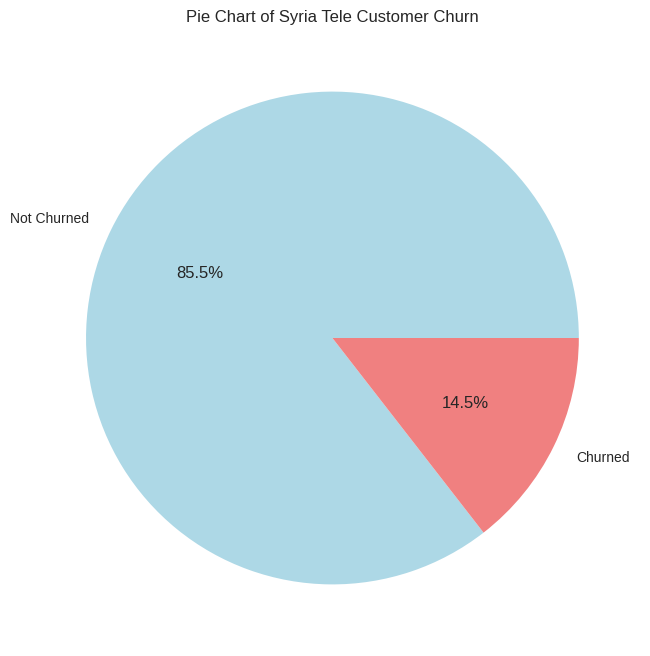

In [271]:
#target variable - Pie Chart
plt.figure(figsize=(10, 8))
labels = ['Not Churned', 'Churned']
data['churn'].value_counts().plot(kind='pie', autopct='%1.1f%%', labels=labels, colors=['lightblue', 'lightcoral'])
plt.title('Pie Chart of Syria Tele Customer Churn')
# Remove y axis
plt.ylabel('')
plt.show()


## Observation
- The churned rate is at 14.5% and the not churned rate is 85.5%. Customer retention is high i this company.


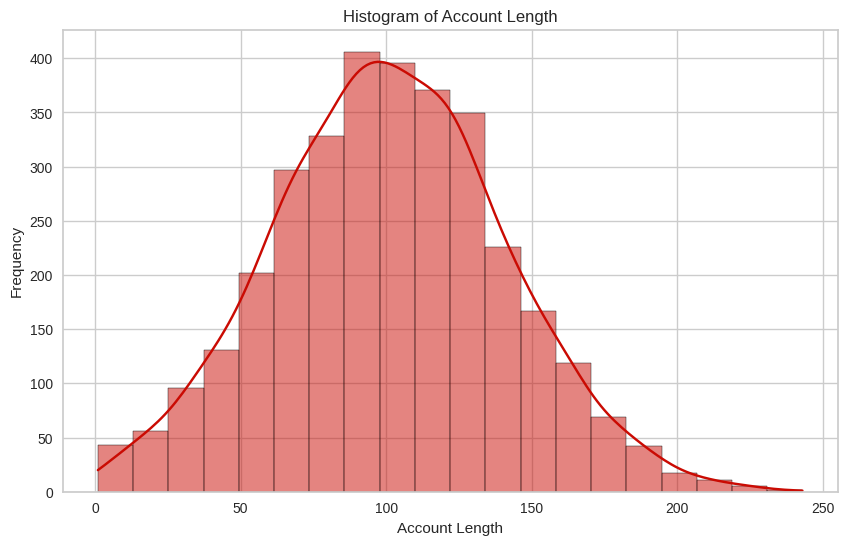

In [272]:
#account length variable
plt.figure(figsize=(10, 6))
sns.histplot(data=data, x='account length', bins=20, kde=True,color='r')
plt.title('Histogram of Account Length')
plt.xlabel('Account Length')
plt.ylabel('Frequency')
plt.show()

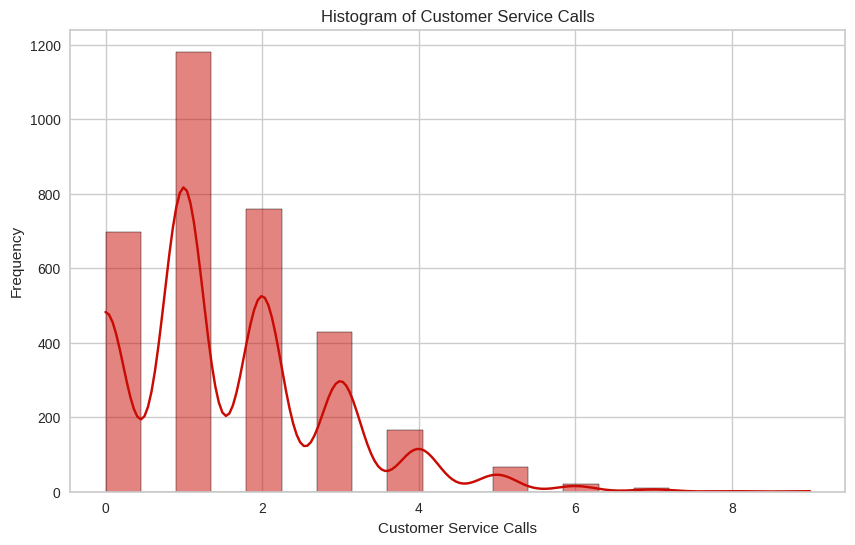

In [273]:
#account length variable (customer service)
plt.figure(figsize=(10, 6))
sns.histplot(data=data, x='customer service calls', bins=20, kde=True,color='r')
plt.title('Histogram of Customer Service Calls')
plt.xlabel('Customer Service Calls')
plt.ylabel('Frequency')
plt.show()

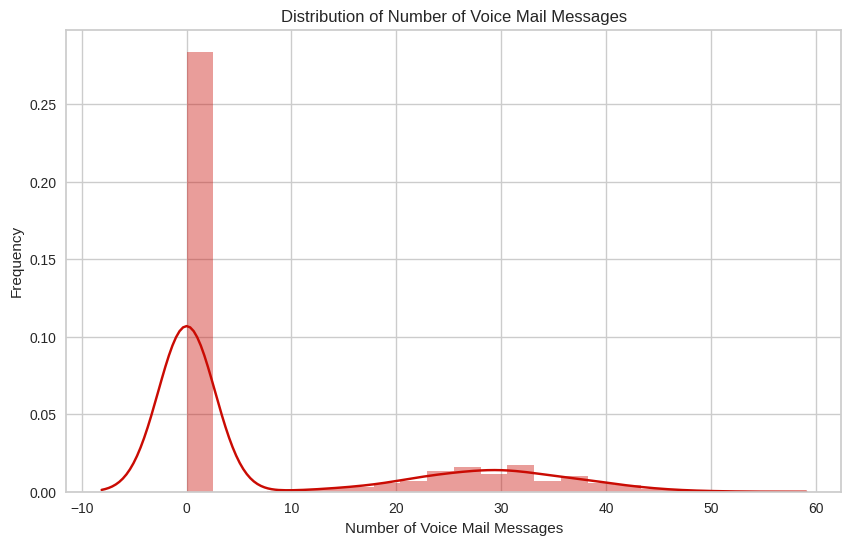

In [274]:
#account length variable(vmail)
plt.figure(figsize=(10, 6))
sns.distplot(data['number vmail messages'],bins=20, kde=True,color='r')
plt.title('Distribution of Number of Voice Mail Messages')
plt.xlabel('Number of Voice Mail Messages')
plt.ylabel('Frequency')
plt.show()

Text(0, 0.5, 'Voice Mail Plan Count')

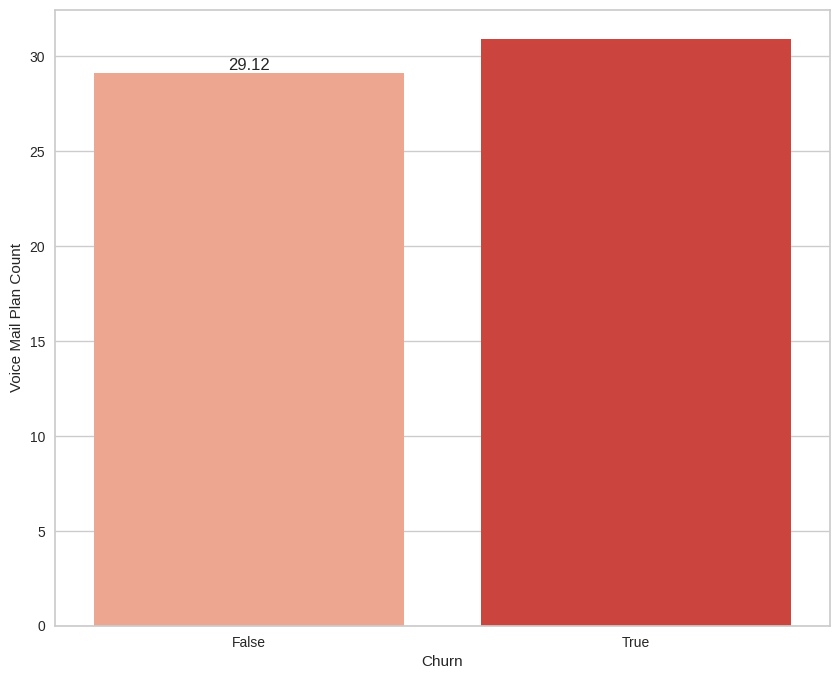

In [275]:
plt.figure(figsize=(10,8))
ax = sns.barplot(data=pivot_table_voice_mail_plan_mean, palette="Reds")
ax.bar_label(ax.containers[0], fmt='%.2f')
plt.xlabel("Churn")
plt.ylabel('Voice Mail Plan Count')

## Bivariate Analysis

- Conduct bivariate analysis on the same variables with the target variables

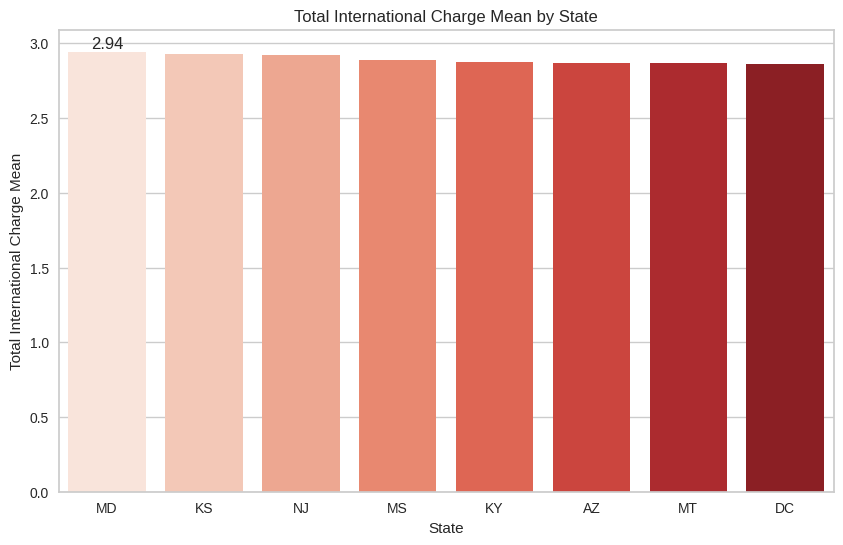

In [276]:
# Plot using seaborn
plt.figure(figsize=(10, 6))
ax =sns.barplot(x='State', y='Total International Charge Mean', data=international_mean_charge,palette='Reds')
ax.bar_label(ax.containers[0], fmt='%.2f')
plt.title('Total International Charge Mean by State')
plt.xlabel('State')
plt.ylabel('Total International Charge Mean')
plt.show()

# Observation

- MD: Maryland

- KS: Kansas

- NJ: New Jersey

- MS: Mississippi

- KY: Kentucky

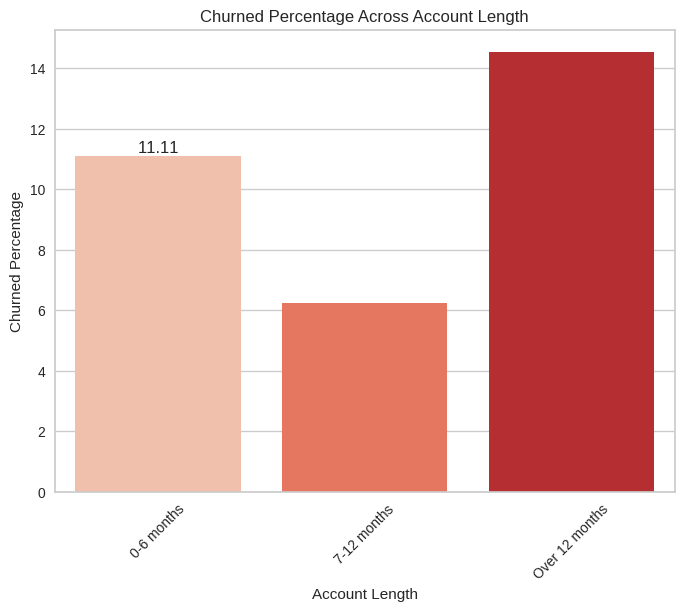

In [277]:
plt.figure(figsize=(8, 6))
ax = sns.barplot(x=churn_table.index, y='Churned Percentage', data=churn_table, palette='Reds')
ax.bar_label(ax.containers[0], fmt='%.2f')
plt.title('Churned Percentage Across Account Length')
plt.xlabel('Account Length')
plt.ylabel('Churned Percentage')
plt.xticks(rotation=45)
plt.show()

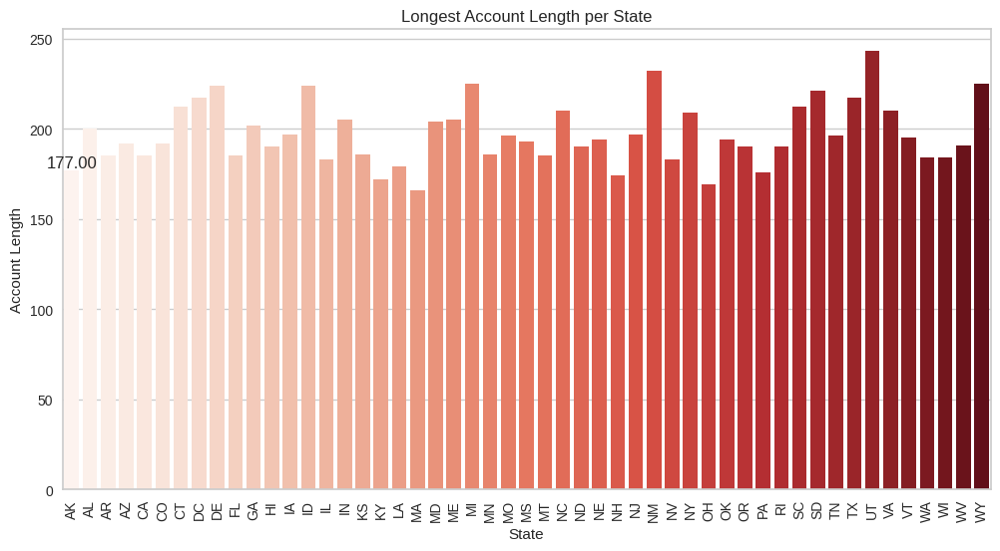

In [278]:
plt.figure(figsize=(12, 6))
ax = sns.barplot(x='state', y='account length', data=account_length_group, palette='Reds')
ax.bar_label(ax.containers[0], fmt='%.2f')
plt.title('Longest Account Length per State')
plt.xlabel('State')
plt.ylabel('Account Length')
plt.xticks(rotation=90)
plt.show()

# Observations

- Account Length Distribution:the duration for which customers have had accounts with the telecom company varies geographically.

    - Utah (UT) has the Longest Account Length with a maximum account length of 243 months.

    - Michigan (MI) and Wyoming (WY) Tie for the Second Longest Account Length both with a maximum account length of 225 months.

    - New Mexico (NM) and Delaware (DE): New Mexico (NM) and Delaware (DE) have account lengths of 232 and 224 months, respectively. While these states do not have the longest account lengths, they still show a considerable duration of customer retention.

Potential Correlation with Customer Churn: Longer account lengths may indicate higher customer loyalty and lower churn rates in those states.

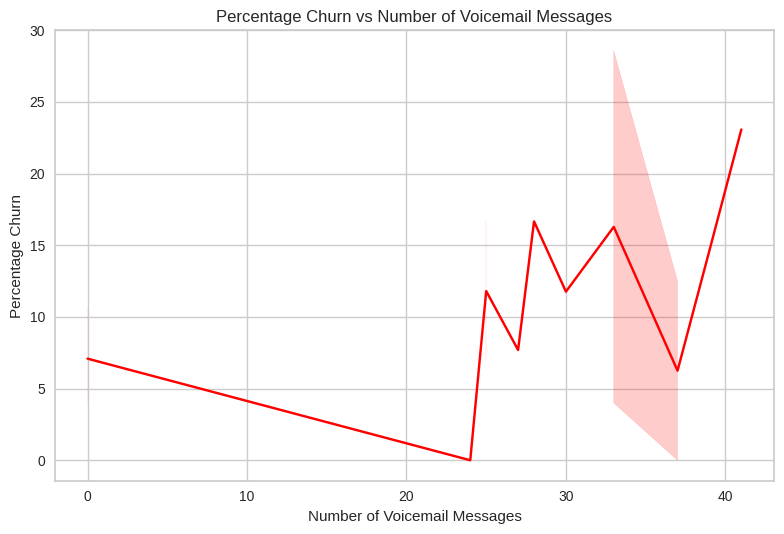

In [279]:
# sns.lineplot(data=international_mean_charge, x=data['number vmail messages'], y=Customer_service_calls_data['Percentage_Churn'], color='red')
sns.lineplot(x=data['number vmail messages'], y=Customer_service_calls_data['Percentage_Churn'], color='red')
plt.xlabel('Number of Voicemail Messages')
plt.ylabel('Percentage Churn')
plt.title('Percentage Churn vs Number of Voicemail Messages')
plt.tight_layout()


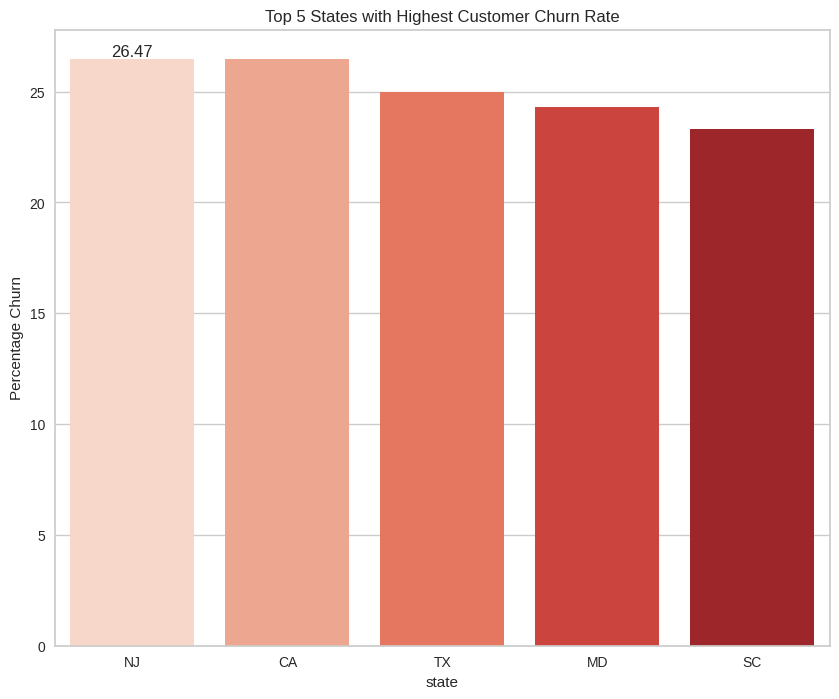

In [280]:
# Visualize the top 10 States with Customer Churn
plt.figure(figsize=(10,8))
ax = sns.barplot(x=top10.index, y='Percentage Churn', data=top10,palette='Reds')
ax.bar_label(ax.containers[0], fmt='%.2f')
plt.title("Top 5 States with Highest Customer Churn Rate")
plt.show()

## Observation

The following states have the highest customer churn:*
- NJ: New Jersey

- CA: California

- TX: Texas

- MD: Maryland

- SC: South Carolina

This may be due to:

1. Network Coverage

2. Competitor Presence

3. Customer Satisfaction

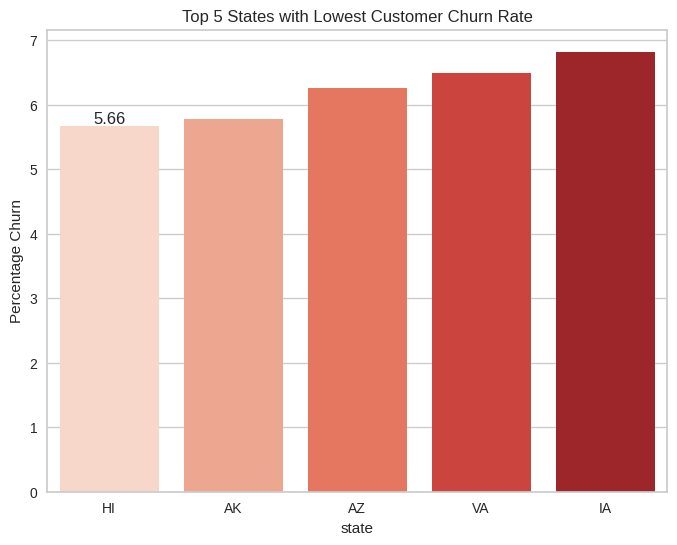

In [281]:
# Visualize the the outcome using sns.barplot
plt.figure(figsize=(8,6))
ax = sns.barplot(x=bottom10.index, y='Percentage Churn', data=bottom10,palette='Reds')
ax.bar_label(ax.containers[0], fmt='%.2f')
plt.title("Top 5 States with Lowest Customer Churn Rate")
plt.show()

# Observation

The top 5 states with the lowest customer churn rate are the following:

- HI: Hawaii

- AK: Alaska

- AZ: Arizona

- VA: Virginia

- IA: Iowa

Text(0, 0.5, 'Customer Service Calls')

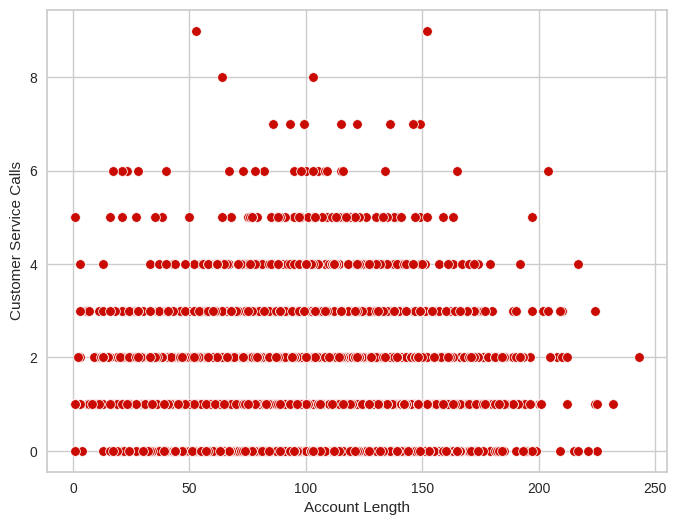

In [282]:
plt.figure(figsize=(8,6))
sns.scatterplot(x=data["account length"],y=data["customer service calls"],color='r')
plt.xlabel('Account Length')
plt.ylabel('Customer Service Calls')

# Multivariate Analysis

In [283]:
# df = pd.DataFrame(data)
print(data.columns)

Index(['state', 'account length', 'international plan', 'voice mail plan',
       'number vmail messages', 'total day minutes', 'total day calls',
       'total day charge', 'total eve minutes', 'total eve calls',
       'total eve charge', 'total night minutes', 'total night calls',
       'total night charge', 'total intl minutes', 'total intl calls',
       'total intl charge', 'customer service calls', 'churn', 'total minutes',
       'total calls', 'total charge'],
      dtype='object')


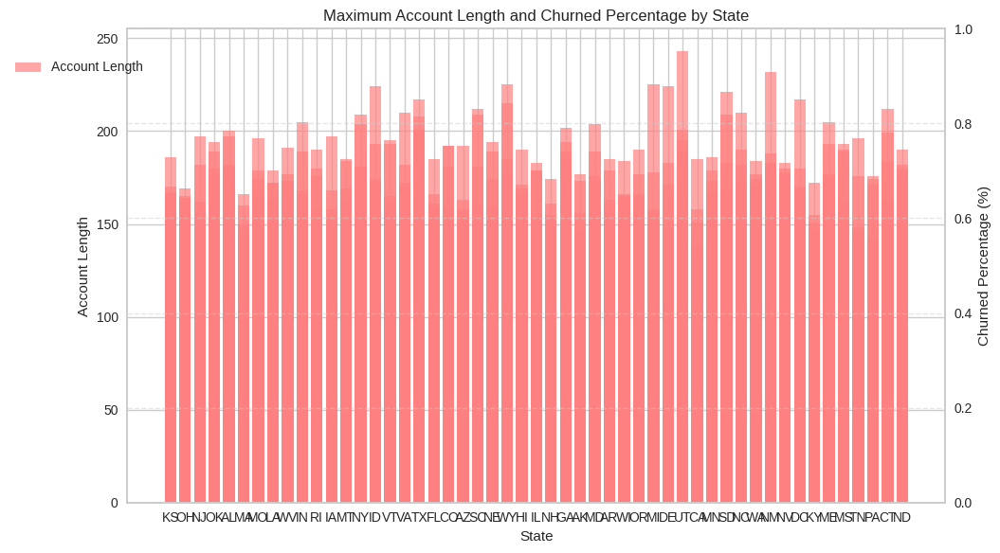

In [295]:
light_red = (1.0, 0.5, 0.5, 0.7)
# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 6))

df=pd.DataFrame(data)
# Plot account length using a bar plot
ax.bar(df['state'], df['account length'], color=light_red, label='Account Length')

# Create a twin Axes sharing the same x-axis
ax2 = ax.twinx()

# Plot churned percentage using a line plot
# ax2.plot(df['state'], df['churn'], marker='o', color='skyblue', label='Churned Percentage')

# Add labels and title
ax.set_title('Maximum Account Length and Churned Percentage by State')
ax.set_xlabel('State')
ax.set_ylabel('Account Length')
ax2.set_ylabel('Churned Percentage (%)')
plt.grid(True, linestyle='--', alpha=0.5)
# Show plot
plt.xticks(rotation=45)
fig.tight_layout()
fig.legend(loc='upper right', bbox_to_anchor=(0.1, 0.9))  # Adjust legend position
plt.show()


## Observation


Churn Rates by State: States such as Idaho (ID), Wyoming (WY), Missouri (MO), Vermont (VT), and Alabama (AL) have relatively higher churn percentages compared to other states in the dataset.


Regional Trends: Certain regions, such as the Midwest (e.g., Missouri), the Mountain West (e.g., Wyoming), and the Northeast (e.g., Vermont), may exhibit higher churn rates compared to others.

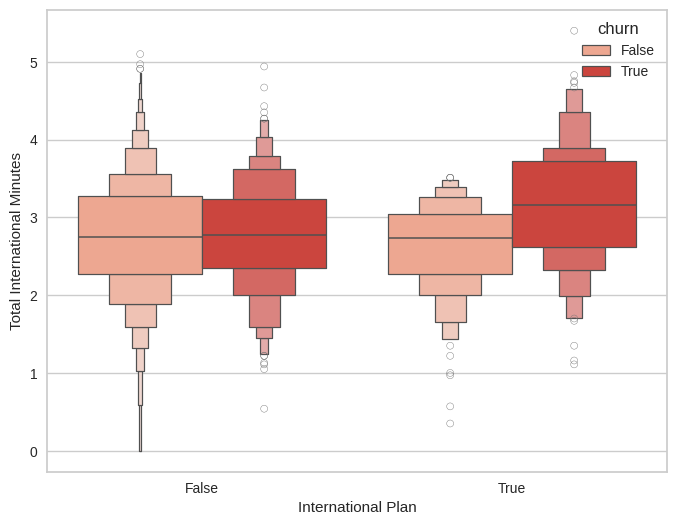

In [284]:
#relationship between International Plan and Total International Minutes
plt.figure(figsize=(8,6))
sns.boxenplot(x='international plan', y='total intl charge', data=data, palette='Reds',hue='churn')
plt.xlabel('International Plan')
plt.ylabel('Total International Minutes')
plt.show()

### Higher churn rate for customers with shorter account lengths (0-6 months):

This segment might represent customers who:

- Signed up for introductory promotional offers that have expired, making the regular service less attractive.

- Experienced service quality issues during the initial period, leading to dissatisfaction (e.g., weak network coverage, billing problems, or difficulties with customer support).

- Have lower initial brand loyalty compared to long-term customers and are more likely to be swayed by competitor offerings.

- Gradual decrease in churn rate with longer tenures: This suggests that customers who stay with SyriaTel for longer periods tend to be more satisfied. They may have:

    - Formed a positive brand perception based on consistent service quality and reliability.

    - Discovered the value beyond introductory offers, potentially including factors like network reliability, diverse plan options, or efficient customer service.



<Figure size 800x600 with 0 Axes>

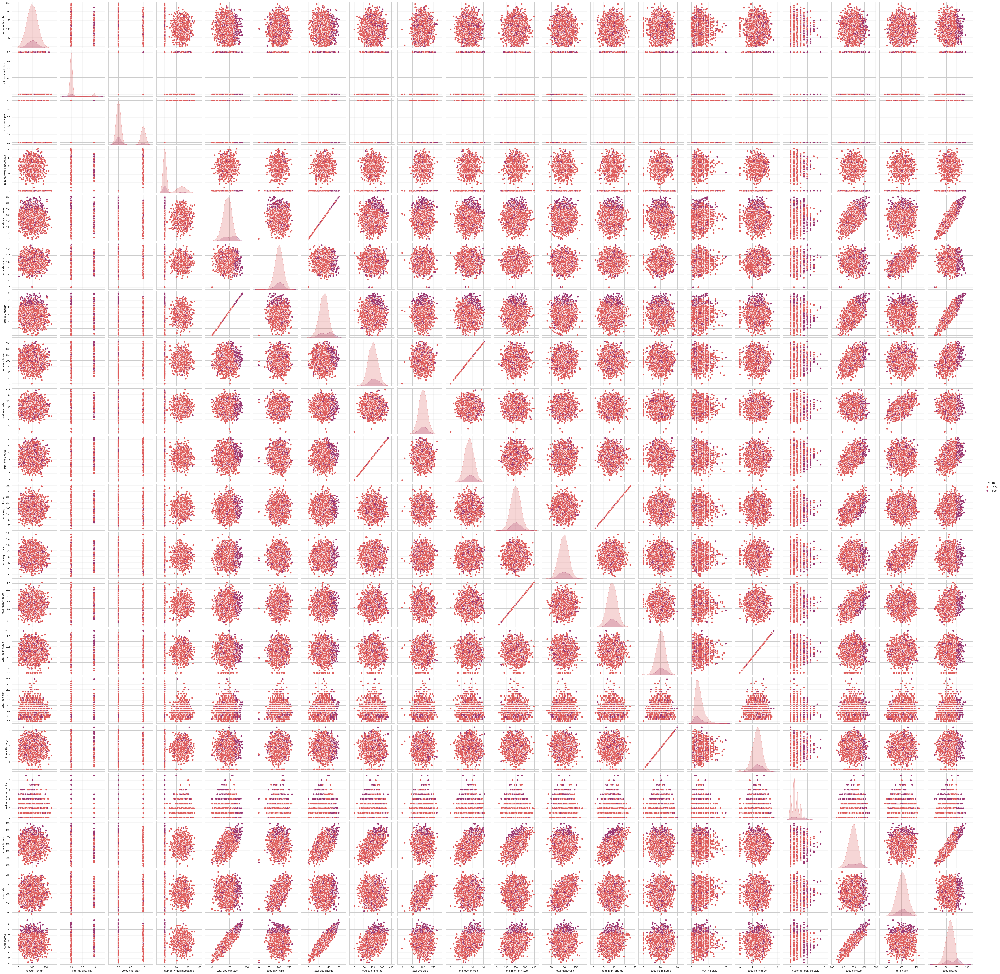

In [215]:
columns = data.columns
plt.figure(figsize=(8,6))
sns.pairplot(data[columns],hue='churn', height=2.75,palette='flare')
plt.show()



## Correlation Analysis

In [216]:
# Convert the copy data frame into numpy inorder to successful get the correaltion matrix
data_copy.to_numpy(dtype=float, na_value=np.nan, copy=False)
# Reorder the copy data frame and put churn in the first column using .reindex()
new_order = ['churn','state', 'account length', 'area code', 'international plan',
       'voice mail plan', 'number vmail messages', 'total intl minutes',
       'total intl calls', 'total intl charge', 'customer service calls', 'total minutes', 'total calls', 'total charge']
data_copy = data_copy.reindex(columns=new_order)


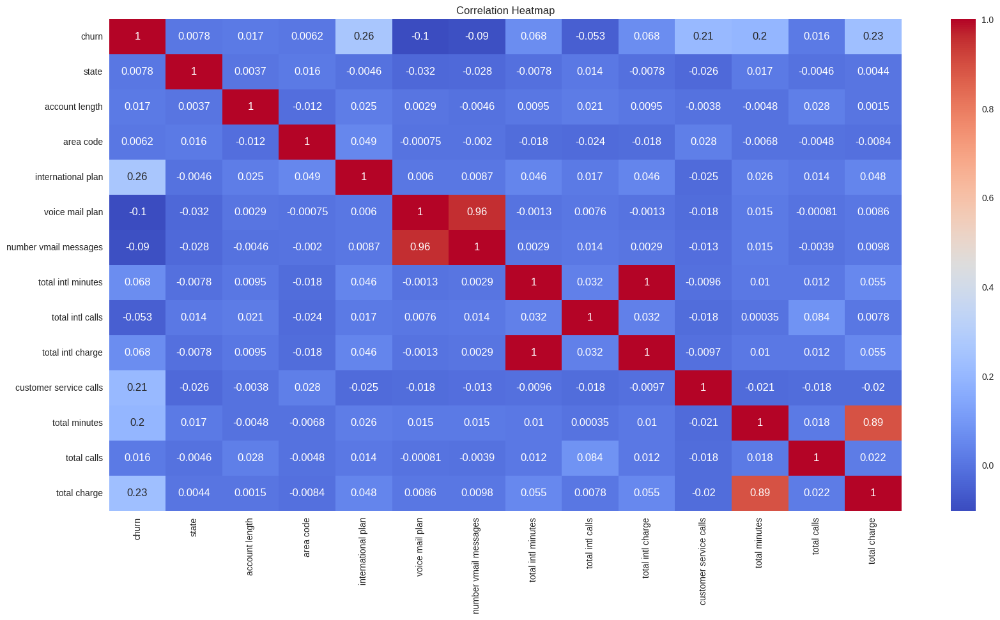

In [217]:
cnf_matrix = data_copy
correlation_matrix = cnf_matrix.corr()
plt.figure(figsize=(20,10))
sns.heatmap(correlation_matrix, annot=True,cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()


In [218]:
data.drop(['total day minutes','total day calls','total day charge','total eve minutes','total night charge','total intl minutes','total intl calls','total intl charge'],axis=1,inplace=True)

# Modelling

- The models choosen have been list including the justification for their selection:
    - Simplicity : Decision Trees are clear and interpretable, so you can see why they predict churn.

    - Powerful: XGBoost is strong at many tasks, including imbalanced data like customer churn.

    - Extra Power: Tuned XGBoost takes a powerful model (XGBoost) and makes it even better for churn prediction.

# Feature Standardization and One Hot Encoding

In [219]:
# One-hot encode column: 'state'
insert_loc = data.columns.get_loc('state')
data = pd.concat([data.iloc[:,:insert_loc], pd.get_dummies(data.loc[:, ['state']]), data.iloc[:,insert_loc+1:]], axis=1)
data.head()

,state_AK,state_AL,state_AR,state_AZ,state_CA,state_CO,state_CT,state_DC,state_DE,state_FL,...,number vmail messages,total eve calls,total eve charge,total night minutes,total night calls,customer service calls,churn,total minutes,total calls,total charge
0,False,False,False,False,False,False,False,False,False,False,...,25,99,16.78,244.7,91,1,False,717.2,303,75.56
1,False,False,False,False,False,False,False,False,False,False,...,26,103,16.62,254.4,103,1,False,625.2,332,59.24
2,False,False,False,False,False,False,False,False,False,False,...,0,110,10.30,162.6,104,0,False,539.4,333,62.29
3,False,False,False,False,False,False,False,False,False,False,...,0,88,5.26,196.9,89,2,False,564.8,255,66.80
4,False,False,False,False,False,False,False,False,False,False,...,0,122,12.61,186.9,121,3,False,512.0,359,52.09


**The dataset has an imbalanced distribution: The dataset might have an imbalanced distribution of churners (101) and non-churners (566). Therefore import the SMOTE libray inorder to address this issue**

In [220]:
os = SMOTE(random_state = 42)

In [221]:
# Create the X and y variable
X = data.drop(['churn'],axis=1)
y = data['churn']
# Initialize StandardScaler
scaler = StandardScaler()
scaler = preprocessing.StandardScaler()
names = X.columns
# Fit scaler to the features and transform them
scaled_std = (scaler.fit_transform(X))

# Convert the scaled features back to a DataFrame
scaled_std = pd.DataFrame(scaled_std, columns=X.columns)
scaled_std.head()

# Train Test Split of the dataset
X_train,X_test,y_train,y_test = train_test_split(scaled_std,y,test_size=0.3,random_state=42)

In [222]:
# Confirm the train and test split
print(X_train.shape,y_train.shape)
print(X_test.shape,y_test.shape)


(2333, 63) (2333,)
(1000, 63) (1000,)


In [223]:
max_depth = 5
min_samples_split = 10
min_samples_leaf = 5
# create a logistic regression variable
decsion_tree_model = DecisionTreeClassifier(max_depth=max_depth, min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf)
#Parameteres of Decision Trees
decsion_tree_model
# Fit the data into the model
decsion_tree_model.fit(X_train,y_train)
# Predict the X_test
y_pred = decsion_tree_model.predict(X_test)

In [224]:
#Replicate the parmeters for the Decision Classifier
max_depth1 = 3
min_samples_split1 = 8
min_samples_leaf1 = 2
#Create a new model with a max depth of 3
tree1 = DecisionTreeClassifier(max_depth=max_depth1, min_samples_split=min_samples_split1, min_samples_leaf=min_samples_leaf1)
#Fit the train data on the new model
tree1.fit(X_train, y_train)
#predict the data
y_pred_t1 = tree1.predict(X_test)


In [225]:
max_depth2 = 5
min_samples_split2 = 6
min_samples_leaf2 = 4
# Decision Tree 2
#Create a new model with a max depth of 5
tree2 = DecisionTreeClassifier(max_depth=max_depth2, min_samples_split=min_samples_split2, min_samples_leaf=min_samples_leaf2)
#Fit the train data on the new model
tree2.fit(X_train, y_train)
#predict the data
y_pred_t2 = tree2.predict(X_test)

In [226]:
# Create a dicitionary key and values
my_dict = {'Actual ':  y_test, 'Prediction ': y_pred}

# Add to a Data Frame
comparison = pd.DataFrame(my_dict)
# Select a random sample of 10
comparison.sample(10)

,Actual,Prediction
2073,False,False
1826,False,False
1717,False,False
1272,False,False
1973,False,False
291,False,False
1105,True,False
2808,False,False
1809,False,False
2929,False,False


## Decision Tree Visualizations

- 2 new decision model trees have been plotted in order to provide a deepeer understanding of how the algorthim classifies the trained data.

Text(0.5, 1.0, 'Decision Tree 1')

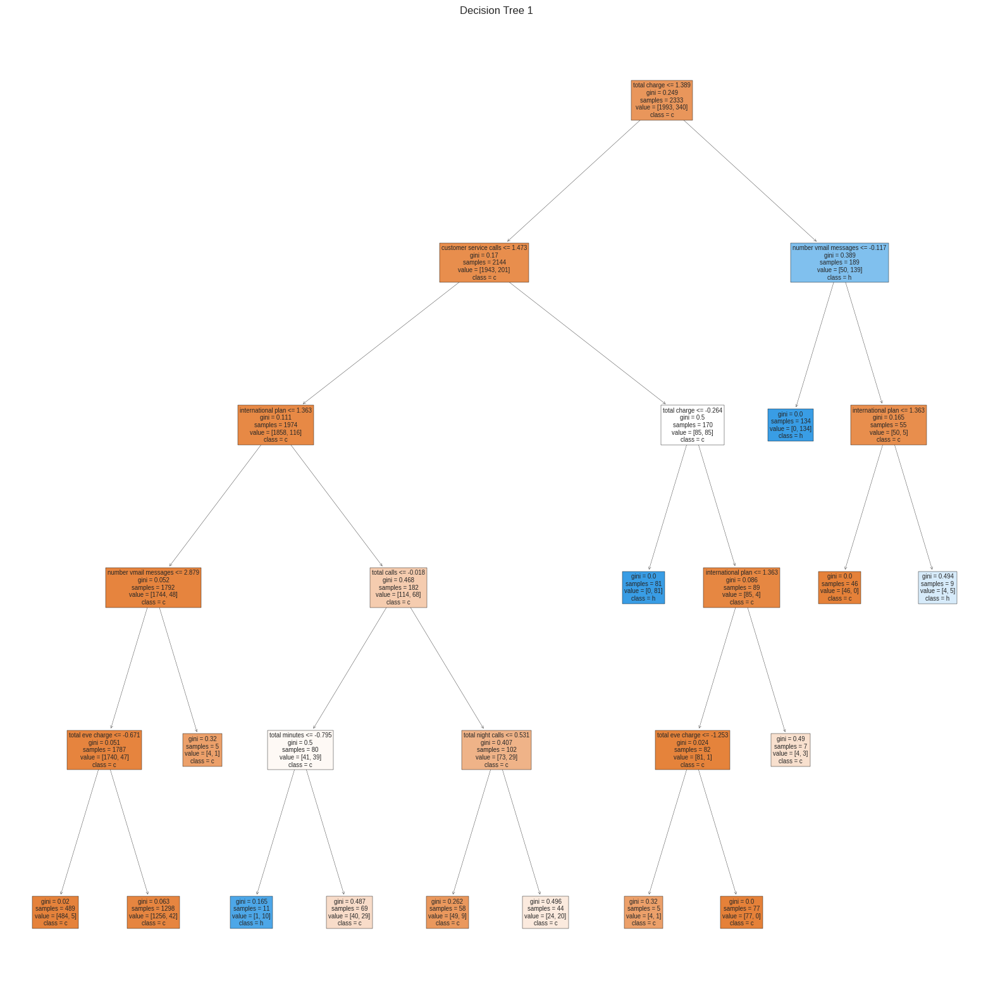

In [227]:
feature_df = X
# Create a list of the columns minus the speices target variable
features = list(feature_df.columns)
#Get the target variables
targets = 'churn'
plt.figure(figsize=(20,20))
tree2 = tree.plot_tree(decsion_tree_model,filled=True, feature_names=features,class_names=targets)
plt.title('Decision Tree 1')

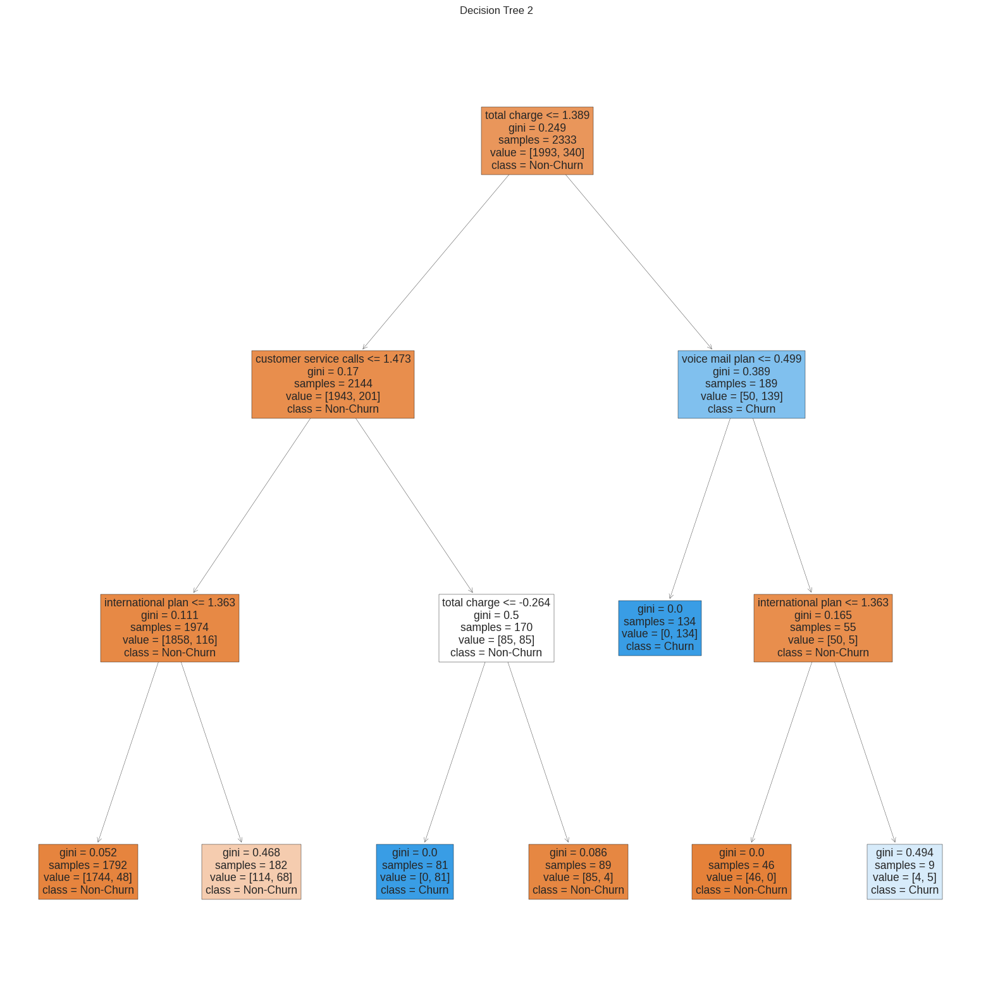

In [228]:
# Plot decision trees
plt.figure(figsize=(20, 20))
t1 = tree.plot_tree(tree1, feature_names=X.columns, class_names=['Non-Churn', 'Churn'], filled=True)
plt.title('Decision Tree 2')

plt.show()

# Evaluation Metrics

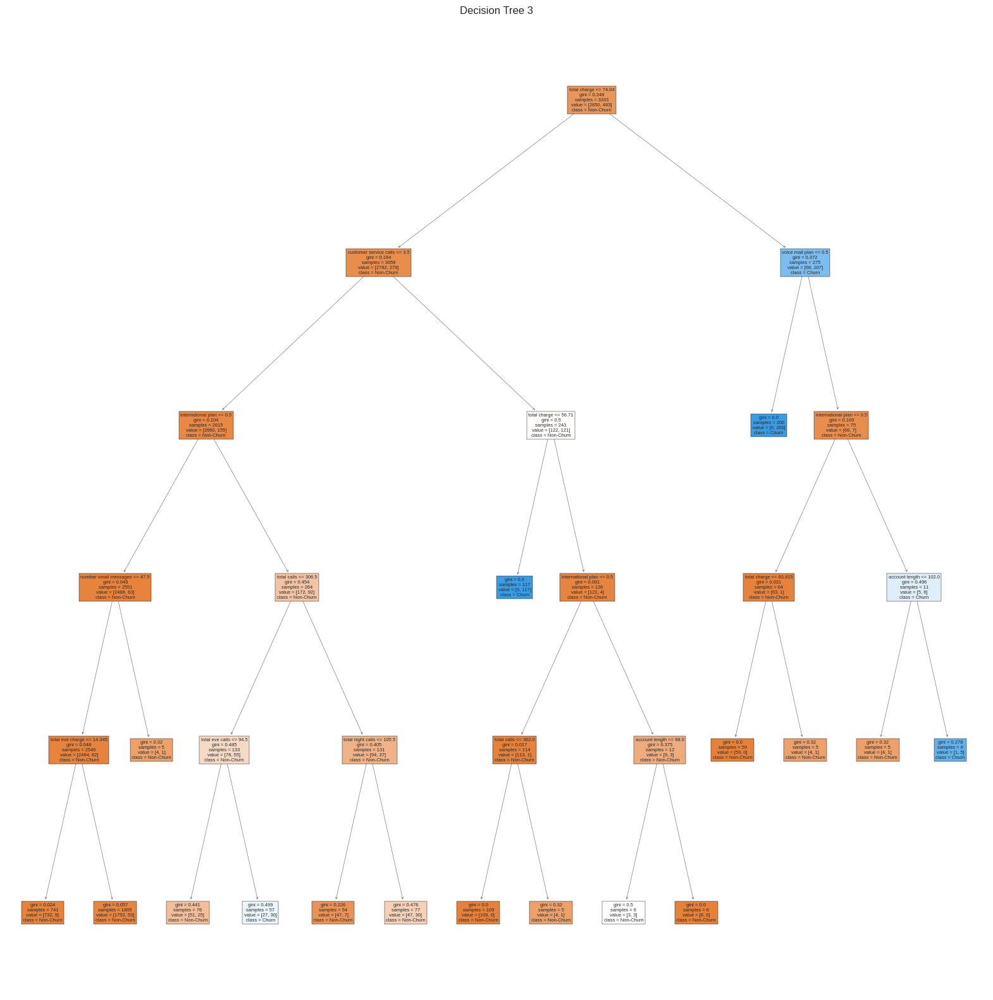

In [229]:
plt.figure(figsize=(20, 20))
tree2 = DecisionTreeClassifier(max_depth=max_depth, min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf)
tree2.fit(X, y)
t2 = tree.plot_tree(tree2, feature_names=X.columns, class_names=['Non-Churn', 'Churn'], filled=True)
plt.title('Decision Tree 3')

plt.show()

In [230]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

       False       0.96      0.99      0.97       857
        True       0.91      0.73      0.81       143

    accuracy                           0.95      1000
   macro avg       0.93      0.86      0.89      1000
weighted avg       0.95      0.95      0.95      1000



In [231]:
print(classification_report(y_test,y_pred_t1))

              precision    recall  f1-score   support

       False       0.96      1.00      0.98       857
        True       0.99      0.72      0.83       143

    accuracy                           0.96      1000
   macro avg       0.97      0.86      0.91      1000
weighted avg       0.96      0.96      0.96      1000



In [232]:
print(classification_report(y_test,y_pred_t2))

              precision    recall  f1-score   support

       False       0.96      0.99      0.97       857
        True       0.91      0.73      0.81       143

    accuracy                           0.95      1000
   macro avg       0.93      0.86      0.89      1000
weighted avg       0.95      0.95      0.95      1000



**The 1st decision tree has the highest metric scores. Therefore only Decision tree one will be analyzed further**

### K-Fold Cross Validation

In [233]:
# Conduct the Cross validation Focusing on Precision
dt_accurcies = cross_val_score(estimator=decsion_tree_model,X=X_train,y=y_train,cv=15,scoring='precision')
dt_accurcies.mean()

0.9203408141566036

In [234]:
auc = roc_auc_score(y_test, y_pred)

print("AUC-ROC:", auc)

AUC-ROC: 0.8607151308434855


In [235]:
cnf_matrix1 = np.array(confusion_matrix(y_test,y_pred))
cnf_matrix1

array([[846,  11],
       [ 38, 105]])

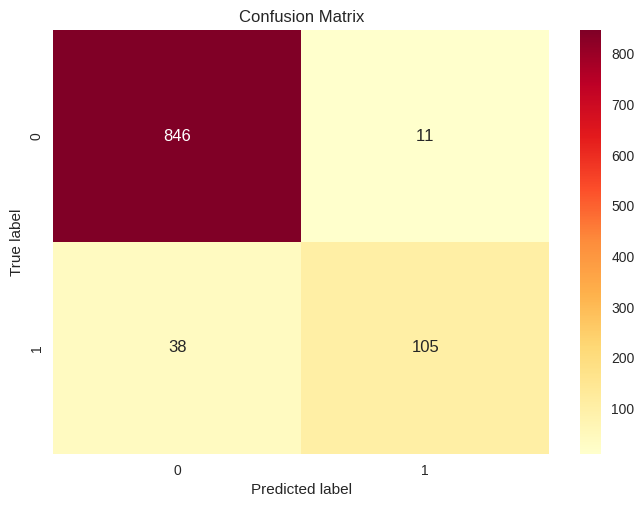

In [236]:
# Create a confusion matrix array
cnf_matrix1 = np.array(confusion_matrix(y_test,y_pred))
cnf_matrix1

# Create a heatmap with clear annotations
sns.heatmap(cnf_matrix1, annot=True, fmt='d', cmap='YlOrRd')

# Set labels for the axes
plt.xlabel('Predicted label')
plt.ylabel('True label')

# Add a title
plt.title('Confusion Matrix')

# Display the visualization
plt.show()

# Overall Performance:

The algorithm has some usefulness for customer churn prediction.



In [237]:
from imblearn.over_sampling import SMOTE

# Apply SMOTE to handle class imbalance
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)
# Initialize XGBoost classifier
xgb_model = XGBClassifier()

# Train the model on resampled data
xgb_model.fit(X_train_resampled, y_train_resampled)
# Predict on test set
y_pred1 = xgb_model.predict(X_test)

# Calculate precision and recall
print(classification_report(y_test, y_pred1))

              precision    recall  f1-score   support

       False       0.97      0.97      0.97       857
        True       0.80      0.80      0.80       143

    accuracy                           0.94      1000
   macro avg       0.88      0.88      0.88      1000
weighted avg       0.94      0.94      0.94      1000



In [238]:
auc = roc_auc_score(y_test, y_pred1)

print("AUC-ROC:", auc)

AUC-ROC: 0.8816819120203016


## Observations

**Model Strengths:**
High Precision for Non-Churn (False Class): A precision of 0.97 indicates the model rarely misclassifies non-churning customers.

**Model Weaknesses:**
While precision is high for both classes, recall for churners (0.80) is concerning. This means the model misses 20% of actual churners, potentially leading to lost revenue or missed retention efforts.

**Areas of Improvements:**
The high overall accuracy and imbalanced class-wise performance (high precision for non-churn, lower recall for churn) could suggest over fitting.
Test on unseen data and apply techniques like L1/L2.

**Improve Churn Recall:** This could involve adjusting model hyper parameters or exploring cost-sensitive learning approaches.

# Hyperparameter Tunning

In [239]:
# Define a hyperparameter grid
param_grid = {
  'learning_rate': [0.05, 0.1, 0.3],
  'n_estimators': [100, 200, 350],
  'max_depth': [4, 6, 8],
  'min_child_weight': [1, 3, 5],
  'gamma': [0, 0.01, 0.1],
  # L1 regularization parameter
  'reg_alpha': [0, 0.01, 0.1],
  # L2 regularization parameter
  'reg_lambda': [1, 10, 100],
}

# Create an XGBoost model
model = XGBClassifier(objective='binary:logistic')

# Create a GridSearchCV object
grid_search = GridSearchCV(estimator=model,
                          param_grid=param_grid,
                          scoring='roc_auc', # You can change the scoring metric here
                          cv=3)

# Fit the grid search to the training data
grid_search.fit(X_train_resampled, y_train_resampled)

# Access the best hyperparameters
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

# Print the best hyperparameters
print("Best hyperparameters:", best_params)

In [240]:
xgb_tuned = XGBClassifier(gamma=0.01, learning_rate= 0.1, max_depth=8, min_child_weight=1,n_estimators= 200, reg_alpha= 0, reg_lambda= 1)
xgb_tuned.fit(X_train_resampled, y_train_resampled)
# Predict on test set
y_pred1 = xgb_tuned.predict(X_test)
# Calculate precision and recall
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

       False       0.96      0.99      0.97       857
        True       0.91      0.73      0.81       143

    accuracy                           0.95      1000
   macro avg       0.93      0.86      0.89      1000
weighted avg       0.95      0.95      0.95      1000



In [241]:
auc = roc_auc_score(y_test, y_pred1)

print("AUC-ROC:", auc)

AUC-ROC: 0.8776060578861046


# Observation

## First Model:

Precision for the "True" class: 0.91
Recall for the "True" class: 0.73
F1-score for the "True" class: 0.81
Accuracy: 0.95

## Second Model:

Precision for the "True" class: 0.80
Recall for the "True" class: 0.80
F1-score for the "True" class: 0.80
Accuracy: 0.94

### Observation:

Precision: Precision measures the accuracy of positive predictions. In the first table, the precision for the "True" class is higher (0.91) compared to the second table (0.80). This indicates that in the first model, when it predicts a customer will churn (positive prediction), it is more likely to be correct.

Recall: Recall measures the ability of the model to correctly identify positive instances. In the first table, the recall for the "True" class is lower (0.73) compared to the second table (0.80). This suggests that the first model may miss more instances of actual churn (false negatives) compared to the second model.

F1-score: The F1-score is the harmonic mean of precision and recall, providing a balance between the two metrics. In the first table, the F1-score for the "True" class is slightly higher (0.81) compared to the second table (0.80), reflecting a slightly better balance between precision and recall.


# Conclusion

## Data Analysis

The dataset provided showed that there is an imbalance in churn distribution acrooss the states. Mutplie states have significantly lower customer churn rates as compared to others for example the lowest state with customer churn is Iowa with a churn of 5.66%  and the state with the highests churn is New Jersy with a churn of 26.470588% .


- The voice mail plan and number of voice mail messages showed that after a general number of voice mails the customer churn rapidly increases around the 20th voice mail messgae. Thr sales and marketing manager should investigate look into voice mail related customer grivences

- Customer that have never subscribered to the international plan have churned less than consumers whom subscribe to the plan. This implies that after consuming the international plan serivce from customers will prefer to search for alternative plans that may offer better serivices and competitve prices.

- The columns total day calls,total day minutes, total day charge,total eve calls,total eve minutes ,area code , account length and total eve charge had no feature importance or significane to customer churn rates.

## Recommendations

1. Give more attention to customers subscribed to international and voice mail plan by giving promotions and discounts.

2. Implementing targeted customer retention programs so as to reduce churn rates. This can be designing international plan packages that cater to different economic classes.  

3. Engaging with customers through feedback mechanisms, such as incentivized surveys, will assist in better pricing, better international plan experiences.

# Model Evaluation

The main limitation of the dataset is the limited data.

**Feature relevance**: The features available in the dataset proved to be informative for ones for predicting churn though including more variables will help in provide more meaningful predictions.

Imbalanced distribution: The dataset might have an imbalanced distribution of churners (101) and non-churners (566). This can bias the model towards the majority class and lead to poor performance in predicting the minority class (churners) however this was addreesed using SMOTE.

## Model Performance

1. Decision Trees Algorithm

The main classification metrics of interest were Precision, Recall and AUC-ROC score, this is due the fact that the purpose of the model was to help staeholders money by clasifying customers who are likely to churn correctly.  

•	**Precision:** The precision for predicting churn (True) is 0.91, indicating that out of all the customers predicted to churn, 91% actually did churn.

•	**Recall:** The recall for predicting churn (True) is 0.73, suggesting that the model correctly identified 73% of all churn cases.

•	**F1-score:** The F1-score for predicting churn (True) is 0.81, indicating a reasonable balance between precision and recall.

• **AUC-ROC score:** this score measures the model's ability to distinguish between positive and negative classes across different thresholds, is 0.861.

2. XGB Classifier Algorithm

The XGB Classifier Algorithm was deemed suitable for this due to it capabilities with handling imbalanced distributions. The classification metrics from the algorthim was above average with the following weakness:

- Model Weaknesses:

Balanced Precision and Recall for Non-Churn, Lower for Churn (True Class): While precision is high for both classes, recall for churners (0.80) is concerning. This means the model misses 20% of actual churners, more importantly the model showed signs of overfitting with it high accuracy and low recall for customer churn.


## XGB Classifier Tuned Performance

After implementing the hyper parameters the models new performance was as follows:

XGBClassifier:

Precision for the "True" class: 0.91
Recall for the "True" class: 0.73
F1-score for the "True" class: 0.81
Accuracy: 0.95

XGBClassifier Tuned:

Precision for the "True" class: 0.80
Recall for the "True" class: 0.80
F1-score for the "True" class: 0.80
Accuracy: 0.94
Here are the observations:

**Precision:** In XGBClassifier, the precision for the "True" class is higher (0.91) compared to the XGBClassifier Tuned (0.80). This indicates that in XGBClassifier, when it predicts a customer will churn (positive prediction), it is more likely to be correct.

**Recall:** In the XGBClassifier, the recall for the "True" class is lower (0.73) compared to the XGBClassifier Tuned (0.80). This suggests that XGBClassifier may miss more instances of actual churn (false negatives) compared to XGBClassifier Tuned.

**F1-score:** In XGBClassifier, the F1-score for the "True" class is slightly higher (0.81) compared to XGBClassifier Tuned (0.80), reflecting a slightly better balance between precision and recall.

**Accuracy:** The accuracy in XGBClassifier is slightly higher (0.95) compared to XGBClassifier Tuned(0.94), indicating that XGBClassifier performs slightly better overall.



